In [39]:
import pandas as pd
import seaborn as sns
import os
import numpy as np
from sklearn.preprocessing import LabelEncoder
import gc
import matplotlib.pyplot as plt
import tqdm
from sklearn.preprocessing import LabelEncoder


pd.set_option('display.max_rows', 1000000000000000000)
pd.set_option('display.max_columns', 1000000000000000000)
#import 

In [40]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')


gc.collect()

4231

In [41]:
train.keys()

Index(['acqic', 'bacno', 'cano', 'conam', 'contp', 'csmcu', 'ecfg', 'etymd',
       'flbmk', 'flg_3dsmk', 'fraud_ind', 'hcefg', 'insfg', 'iterm', 'locdt',
       'loctm', 'mcc', 'mchno', 'ovrlt', 'scity', 'stocn', 'stscd', 'txkey'],
      dtype='object')

In [42]:
print('Initial Separate_dt.....')
train['Month'] = 0
train.loc[train['locdt'] < 121, 'Month'] = 4
train.loc[train['locdt'] < 91, 'Month']  = 3
train.loc[train['locdt'] < 61, 'Month']  = 2
train.loc[train['locdt'] < 31, 'Month'] = 1

test['Month'] = 0
test.loc[test['locdt'] < 121, 'Month'] = 4
test.loc[test['locdt'] < 91, 'Month']  = 3
test.loc[test['locdt'] < 61, 'Month']  = 2
test.loc[test['locdt'] < 31, 'Month'] = 1


Initial Separate_dt.....


# Target Distribution

In [43]:
print('1 and 0 proportion : {}'.format(20355/1501432))
train.fraud_ind.value_counts()

1 and 0 proportion : 0.013557057529078907


0    1501432
1      20355
Name: fraud_ind, dtype: int64

# bacno 歸戶帳號

In [44]:
print('train unique account :', len(train))
print('test unique account :', len(test))
print('-'*100)
print('train account in test account : ', len(train.bacno[train.bacno.isin(test.bacno)]))
print('train account not in test account : ', len(train.bacno[~train.bacno.isin(test.bacno)]))
print('-'*100)
print('month_1 account in in test account', len(train.bacno[(train.Month == 1) &(train.bacno.isin(test.bacno))]))
print('month_1 account in not in test account', len(train.bacno[(train.Month == 1) & ~(train.bacno.isin(test.bacno))]))
print('-'*100)
print('month_2 account in in test account', len(train.bacno[(train.Month == 2) &(train.bacno.isin(test.bacno))]))
print('month_2 account in not in test account', len(train.bacno[(train.Month == 2) & ~(train.bacno.isin(test.bacno))]))
print('-'*100)
print('month_3 account in in test account', len(train.bacno[(train.Month == 3) &(train.bacno.isin(test.bacno))]))
print('month_3 account in not in test account', len(train.bacno[(train.Month == 3) & ~(train.bacno.isin(test.bacno))]))



train unique account : 1521787
test unique account : 421665
----------------------------------------------------------------------------------------------------
train account in test account :  65031
train account not in test account :  1456756
----------------------------------------------------------------------------------------------------
month_1 account in in test account 21725
month_1 account in not in test account 493345
----------------------------------------------------------------------------------------------------
month_2 account in in test account 21524
month_2 account in not in test account 478197
----------------------------------------------------------------------------------------------------
month_3 account in in test account 21782
month_3 account in not in test account 485214


<Figure size 864x1152 with 0 Axes>

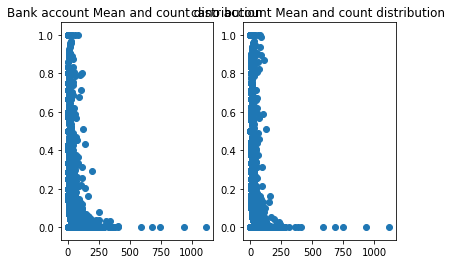

In [45]:
df = train.groupby('bacno')['fraud_ind'].agg(['count', 'mean']).reset_index()
fig = plt.figure(figsize=(12,16))
fig, ax = plt.subplots(1,2)
ax[0].scatter(df['count'], df['mean'])
_ = ax[0].set_title('Bank account Mean and count distribution ')

df = train.groupby('cano')['fraud_ind'].agg(['count', 'mean']).reset_index()
ax[1].scatter(df['count'], df['mean'])
_ = ax[1].set_title('cano account Mean and count distribution ')

<Figure size 576x2016 with 0 Axes>

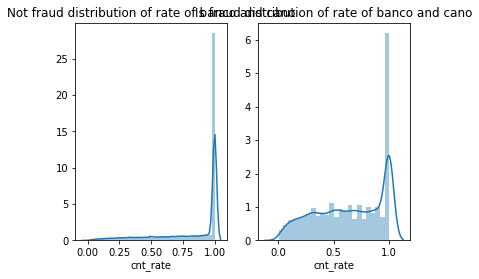

In [46]:
train['bacbo_Cnt'] = train.groupby('bacno')['fraud_ind'].transform('count')
train['cano_Cnt'] = train.groupby('cano')['fraud_ind'].transform('count')
train['cnt_rate'] = train['cano_Cnt'] / train['bacbo_Cnt']

fig = plt.figure(figsize=(8,28))
fig, ax = plt.subplots(1,2)
sns.distplot(train.loc[train['fraud_ind'] == 0, 'cnt_rate'], ax = ax[0])
_ = ax[0].set_title('Not fraud distribution of rate of banco and cano')
sns.distplot(train.loc[train['fraud_ind'] == 1, 'cnt_rate'], ax = ax[1])
_ = ax[1].set_title('Is fraud distribution of rate of banco and cano')

<Figure size 576x2016 with 0 Axes>

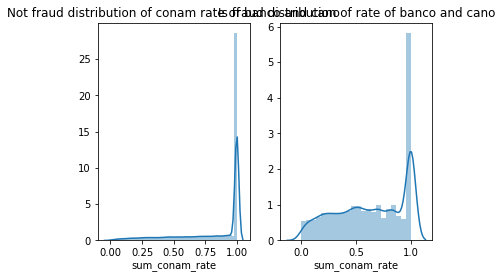

In [47]:
train['bacbo_conam_sum'] = train.groupby('bacno')['conam'].transform('sum')
train['cano_conam_sum'] = train.groupby('cano')['conam'].transform('sum')
train['sum_conam_rate'] = train['cano_conam_sum'] / train['bacbo_conam_sum']
train['sum_conam_rate'].fillna('0', inplace = True)

train.sum_conam_rate = train.sum_conam_rate.astype('float32')

fig = plt.figure(figsize=(8,28))
fig, ax = plt.subplots(1,2)
sns.distplot(train.loc[train['fraud_ind'] == 0, 'sum_conam_rate'], ax = ax[0])
_ = ax[0].set_title('Not fraud distribution of conam rate of banco and cano')
sns.distplot(train.loc[train['fraud_ind'] == 1, 'sum_conam_rate'], ax = ax[1])
_ = ax[1].set_title('Is fraud distribution of rate of banco and cano')

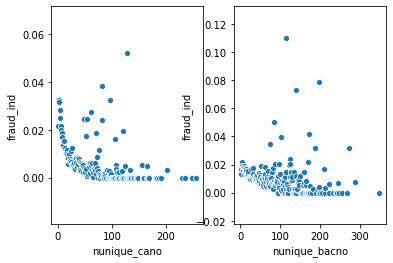

In [60]:
train['nunique_cano'] = train.groupby('cano')['conam'].transform('nunique')
train['nunique_bacno'] = train.groupby('bacno')['conam'].transform('nunique')
fig, axs = plt.subplots(1,2)
df = train.groupby(['nunique_cano'])['fraud_ind'].mean().reset_index()
sns.scatterplot(df['nunique_cano'], df['fraud_ind'], ax = axs[0])
df = train.groupby(['nunique_bacno'])['fraud_ind'].mean().reset_index()
sns.scatterplot(df['nunique_bacno'], df['fraud_ind'], ax = axs[1])

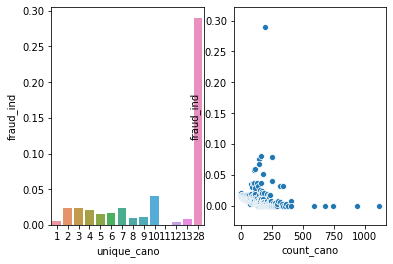

In [56]:
train['unique_cano'] = train.groupby(['bacno'])['cano'].transform('nunique')
train['count_cano'] = train.groupby(['bacno'])['cano'].transform('count')

fig, ax = plt.subplots(1,2)
df = train.groupby('unique_cano')['fraud_ind'].mean().reset_index()
sns.barplot(df['unique_cano'], df['fraud_ind'], ax=ax[0])
df = train.groupby('count_cano')['fraud_ind'].mean().reset_index()
sns.scatterplot(df['count_cano'], df['fraud_ind'], ax=ax[1])

In [63]:
train['cbt_trs_cano'] = train.groupby('cano')['fraud_ind'].transform('count')
train.groupby(['bacno'])['cano'].transform(lambda S: S.mode()[0])

0           38038
1           45725
2          188328
3           29967
4           81305
5            2295
6           49219
7          177989
8           85535
9          110755
10          57083
11           4485
12          47685
13         178029
14         161279
15         197751
16           4542
17          42064
18           5398
19          65948
20         133430
21         149724
22         115453
23         145047
24         209978
25         210026
26          83784
27         141522
28         208050
29          25295
30          88760
31         196047
32         135834
33         135086
34         134314
35         158329
36          16012
37         142609
38          28641
39         151426
40         147083
41         172021
42          91466
43          87141
44         135418
45         181915
46          59422
47          33085
48          95705
49         142605
50         206628
51         162977
52         161228
53         185426
54          33931
55        

In [ ]:

def Mode(x):
    

## locdt 授權日期

In [4]:
train.locdt.unique()

array([33,  9,  6,  5,  7, 10,  8, 11, 13, 14, 22, 21, 25, 24, 15, 12, 19,
       28, 18, 17, 16, 23, 31, 26,  2, 30,  4, 20, 27, 29,  1,  3, 34, 66,
       32, 67, 70, 69, 65, 35, 39, 43, 38, 45, 48, 54, 50, 68, 36, 37, 61,
       42, 49, 44, 58, 62, 60, 63, 47, 40, 41, 46, 76, 51, 74, 75, 52, 56,
       85, 53, 89, 86, 73, 55, 57, 59, 79, 78, 72, 71, 64, 80, 81, 84, 77,
       82, 87, 88, 83, 90])

# loctm 授權時間

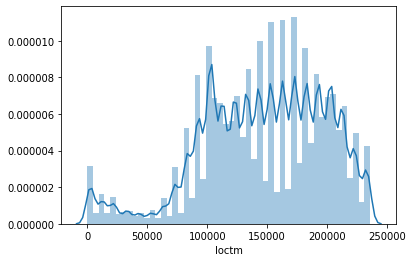

In [4]:
sns.distplot(train.loctm)

In [5]:
def Str_turn_time(str1):
    #print('Initial Process_loctm.....')
    str1 = str(int(str1))
    if len(str1) < 6:
        str1 = (6 - len(str1)) * '0' + str1

    return str1
 
        
train['Hour'] = train['loctm'].apply(lambda x :Str_turn_time(x)[:2])
train['Minute'] = train['loctm'].apply(lambda x :Str_turn_time(x)[2:4])
train['Second'] = train['loctm'].apply(lambda x :Str_turn_time(x)[4:6])

Text(0.5, 1.0, 'Count fraud rate every hour')

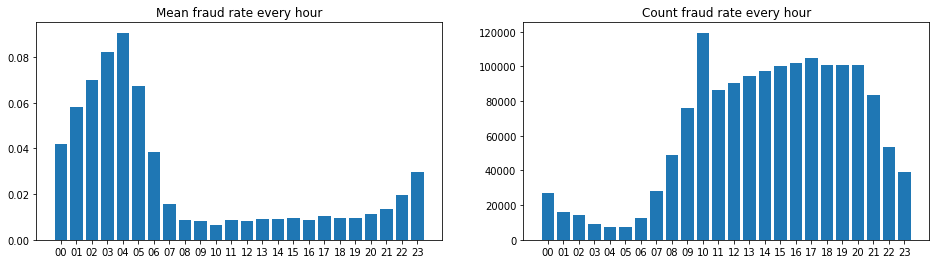

In [6]:
Df = train.groupby(['Hour'])['fraud_ind'].agg(['mean', 'count']).reset_index()
fig, axes = plt.subplots(1,2, figsize=(16,4))
axes[0].bar(Df['Hour'], Df['mean'])
axes[1].bar(Df['Hour'], Df['count'])
axes[0].set_title('Mean fraud rate every hour')
axes[1].set_title('Count fraud rate every hour')

In [7]:
train.groupby(['bacno', 'loctm', 'Hour'])['fraud_ind'].agg(['mean', 'count']).reset_index()[:5]

,bacno,loctm,Hour,mean,count
0,1,132904.0,13,0.0,1
1,1,134734.0,13,0.0,1
2,1,144817.0,14,0.0,1
3,1,150512.0,15,0.0,1
4,1,192933.0,19,0.0,1


# cano  交易卡號

In [26]:
train[['bacno', 'cano', 'Month', 'fraud_ind']].sort_values(['bacno', 'cano', 'Month'])[:1000]

,bacno,cano,Month,fraud_ind
502741,1,117264,1,0
606676,1,117264,1,0
994932,1,117264,1,0
1388156,1,117264,1,0
10441,1,117264,2,0
617285,1,117264,2,0
621811,1,117264,2,0
327323,1,117264,3,0
545593,1,117264,3,0
1106685,1,117264,3,0


In [17]:
print('train unique account :', len(train))
print('test unique account :', len(test))
print('-'*100)
print('train credit card account in test credit card account : ', len(train[train.cano.isin(test.cano)]))
print('train credit card account not in test credit card account : ', len(train[~train.cano.isin(test.cano)]))
print('-'*100)
print('month_1 credit card account in in test credit card account', len(train[(train.Month == 1) &(train.cano.isin(test.cano))]))
print('month_1 credit card account in not in test credit card account', len(train[(train.Month == 1) & ~(train.cano.isin(test.cano))]))
print('-'*100)
print('month_2 credit card account in in test credit card account', len(train[(train.Month == 2) &(train.cano.isin(test.cano))]))
print('month_2 credit card account in not in test credit card account', len(train[(train.Month == 2) & ~(train.cano.isin(test.cano))]))
print('-'*100)
print('month_3 credit card account in in test credit card account', len(train[(train.Month == 3) &(train.cano.isin(test.cano))]))
print('month_3 credit card account in not in test credit card account', len(train[(train.Month == 3) & ~(train.cano.isin(test.cano))]))



train unique account : 1521787
test unique account : 421665
----------------------------------------------------------------------------------------------------
train credit card account in test credit card account :  58455
train credit card account not in test credit card account :  1463332
----------------------------------------------------------------------------------------------------
month_1 credit card account in in test credit card account 18479
month_1 credit card account in not in test credit card account 496591
----------------------------------------------------------------------------------------------------
month_2 credit card account in in test credit card account 19297
month_2 credit card account in not in test credit card account 480424
----------------------------------------------------------------------------------------------------
month_3 credit card account in in test credit card account 20679
month_3 credit card account in not in test credit card account 486317

In [22]:
df = train.groupby('cano')['fraud_ind'].mean().reset_index()
len(df[df.fraud_ind == 0]['cano'])

120683

In [17]:
print(len(test.cano.unique()), test.cano.isin(df[df.fraud_ind == 1]['cano']).sum())

86808 160


In [21]:
train[train.cano.isin(df[df.fraud_ind == 1]['cano'])]['Month'].value_counts()

1    1282
2     672
3     393
Name: Month, dtype: int64

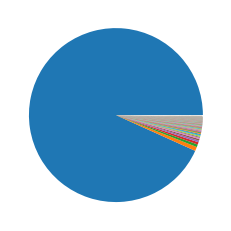

In [11]:
fig = plt.figure(figsize=(8,4))
df[]

# mchno 特店代號

In [4]:
len(train.mchno.unique())

89316

In [23]:
list1 = train['mchno'].value_counts().values[:5]
train['mchno_t'] = train['mchno'].apply(lambda x : 0 if x not in list1 else x)

In [19]:
le = LabelEncoder()
train['mchno_t'] = le.fit_transform(train['mchno_t'])

In [3]:
Df = train.groupby(['mchno'])['fraud_ind'].agg(['mean', 'count']).reset_index().sort_values('count', ascending = False)
No_fraud_df = Df[(Df['mean'] == 0)] 
print(len(No_fraud_df), No_fraud_df['count'].sum())
#No_fraud_df = Df[(Df['mean'] == 0) & (Df['count'] > 10)][['mchno', 'count']] 
#print(len(No_fraud_df), No_fraud_df['count'].sum())


87316 1024261


In [4]:
count = 0
for i in test.mchno:
    if i in No_fraud_df.mchno.to_numpy():
        count+=1
print(len(test), count)

421665 261021


In [16]:
pd.DataFrame({'mchno_id' :test.loc[test.mchno.isin(No_fraud_df.mchno.to_numpy()), 'txkey']})

,mchno_id
12,900425
13,1611461
14,215591
15,1751664
16,185563
...,...
421660,1187507
421661,1182598
421662,898724
421663,971467


In [17]:
pd.DataFrame({'txkey_id' :test.loc[test.mchno.isin(No_fraud_df.mchno.to_numpy()), 'txkey']}).to_csv('Attachment/mchno_fraud_ind.csv', index = False)

In [42]:
train_mchno = train.groupby(['mchno'])['txkey'].agg(['count']).reset_index().sort_values('count', ascending = False)
test_mchno = test.groupby(['mchno'])['txkey'].agg([ 'count']).reset_index().sort_values('count', ascending = False)

# acqic 收單行代碼
* Title

In [22]:
len(train.acqic.unique())

6051

In [23]:
Df = train.groupby(['acqic'])['fraud_ind'].agg(['mean', 'count']).reset_index().sort_values('count', ascending = False)
Df[:100]


,acqic,mean,count
5945,6769,0.001040,250889
5895,6716,0.000695,201407
5226,5975,0.000376,124951
6047,6881,0.001741,99348
5411,6189,0.000689,91434
5943,6767,0.000456,81227
5275,6032,0.002506,62241
5452,6231,0.000601,54942
0,0,0.000229,47940
2912,3348,0.089713,44932


# mcc   MCC_CODE

In [25]:
len(train.mcc.unique())

434

# conam 交易金額-台幣

In [20]:
train['conam'].dtypes

dtype('float64')

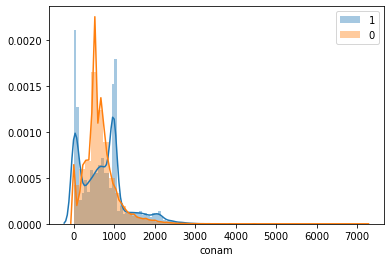

In [31]:
fig = plt.figure()

sns.distplot(train[train.fraud_ind == 1]['conam'], label = 1)
sns.distplot(train[train.fraud_ind == 0]['conam'], label = 0)
plt.legend()

# ecfg 網路交易註記

In [11]:
train.ecfg

0          N
1          N
2          N
3          N
4          N
          ..
1521782    Y
1521783    Y
1521784    Y
1521785    Y
1521786    N
Name: ecfg, Length: 1521787, dtype: object

## insfg 分期交易註記

In [23]:
train.ecfg.unique()

array(['N', 'Y'], dtype=object)

In [25]:
len(train[(train['ecfg'] == 'Y') & (train['insfg']) == 'Y']])

387275

In [28]:
print(len(train[(train['ecfg'] == 'Y') & (train['insfg'] == 'Y')]))
print(len(train[(train['ecfg'] == 'Y') & (train['insfg'] == 'N')]))
print(len(train[(train['ecfg'] == 'N') & (train['insfg'] == 'Y')]))
print(len(train[(train['ecfg'] == 'N') & (train['insfg'] == 'N')]))


18635
368640
23677
1110835


## iterm 分期期數

Text(0.5, 1.0, 'Count fraud rate every iterm')

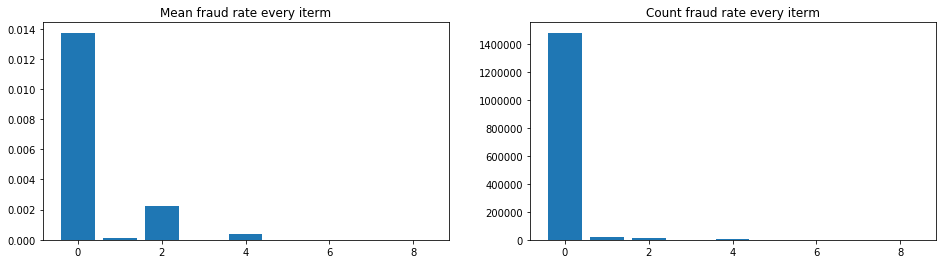

In [32]:
Df = train.groupby(['iterm'])['fraud_ind'].agg(['mean', 'count']).reset_index()
fig, axes = plt.subplots(1,2, figsize=(16,4))
axes[0].bar(Df['iterm'], Df['mean'])
axes[1].bar(Df['iterm'], Df['count'])
axes[0].set_title('Mean fraud rate every iterm')
axes[1].set_title('Count fraud rate every iterm')

## stocn 消費地國別

In [4]:
train['stocn_scity'] = train['stocn'] + train['scity']

In [8]:
df = train.groupby('stocn_scity')['fraud_ind'].agg({'mean', 'count'}).reset_index()

In [10]:
df.sort_values('count', ascending= False)

,stocn_scity,count,mean
3740,5919,726391,0.000957
60,102,133623,0.001422
3743,5922,86415,0.000845
3723,5902,46555,0.000150
2355,3690,40572,0.000173
2241,3506,38309,0.070010
4190,6618,37567,0.091783
3768,5960,32820,0.000183
2941,4628,23082,0.000910
3726,5905,19825,0.001261


## stscd 狀態碼

Text(0.5, 1.0, 'Count fraud rate every stscd')

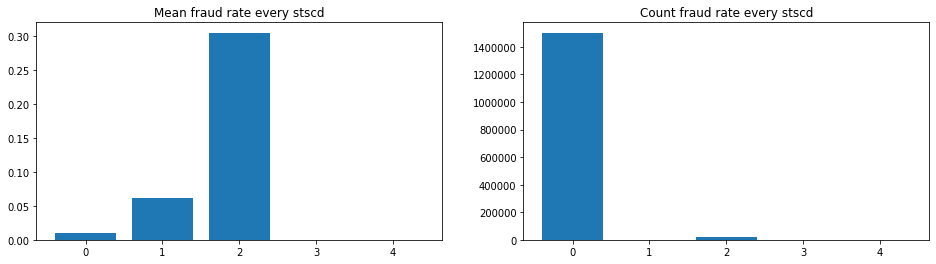

In [33]:
Df = train.groupby(['stscd'])['fraud_ind'].agg(['mean', 'count']).reset_index()
fig, axes = plt.subplots(1,2, figsize=(16,4))
axes[0].bar(Df['stscd'], Df['mean'])
axes[1].bar(Df['stscd'], Df['count'])
axes[0].set_title('Mean fraud rate every stscd')
axes[1].set_title('Count fraud rate every stscd')

## ovrlt 超額註記碼

In [34]:
train.ovrlt.unique()

array(['N', 'Y'], dtype=object)

## flbmk Fallback 註記

In [37]:
train.fillna('O', inplace= True)

In [38]:
train.groupby(['flbmk'])['fraud_ind'].mean()

flbmk
N    0.013345
O    0.015500
Y    0.017150
Name: fraud_ind, dtype: float64

# hcefg 支付形態

Text(0.5, 1.0, 'Count fraud rate every hcefg')

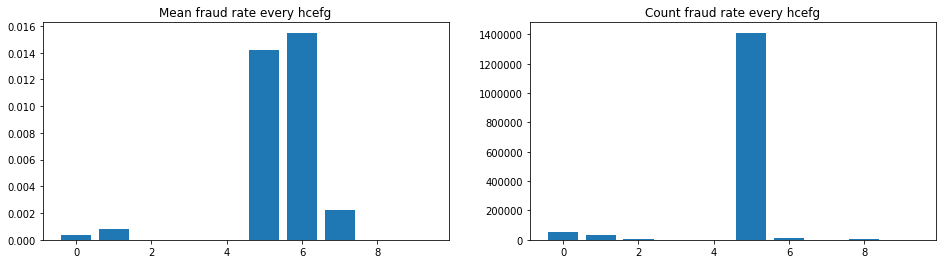

In [42]:
Df = train.groupby(['hcefg'])['fraud_ind'].agg(['mean', 'count']).reset_index()
fig, axes = plt.subplots(1,2, figsize=(16,4))
axes[0].bar(Df['hcefg'], Df['mean'])
axes[1].bar(Df['hcefg'], Df['count'])
axes[0].set_title('Mean fraud rate every hcefg')
axes[1].set_title('Count fraud rate every hcefg')

## csmcu 消費地幣別

In [52]:
train.csmcu.unique()

array([ 0, 62, 74, 61, 13, 67, 60, 26, 49, 10, 71, 56, 20, 38, 22,  4, 47,
       54, 75, 32, 66, 29, 28, 14, 50, 30, 31, 45, 24, 40, 35, 59,  3, 48,
       63, 52, 41, 23, 17, 16, 73, 51, 53, 44, 18, 12, 15,  5, 70, 21, 39,
       27, 42, 11, 72,  6, 25,  7, 43,  2, 19, 37,  1, 64, 57, 36, 68, 55,
        9, 46, 34, 69])

In [3]:
train['flg_3dsmk'].isna().sum()

12581

## flg_3dsmk 3DS 交易註記

In [14]:
le = LabelEncoder()
train['flg_3dsmk'].fillna('O', inplace=True)
train.flg_3dsmk.unique()

array(['N', 'Y', 'O'], dtype=object)

In [15]:
train.groupby('flg_3dsmk')['fraud_ind'].mean()

flg_3dsmk
N    0.013884
O    0.015500
Y    0.001554
Name: fraud_ind, dtype: float64

In [5]:
train.groupby('flg_3dsmk')['fraud_ind'].count()

flg_3dsmk
N    1444867
Y      64339
Name: fraud_ind, dtype: int64

## fraud_ind

In [61]:
len(train[train.conam == 0])

46373

In [79]:
rec = pd.read_csv('Record/10-22-22-05Record.csv')
print(rec.loc[rec.Filename == 'Submission/10-22-22-05.csv', 'Lgb_parama'].iloc[0])

{'num_leaves': 64, 'min_child_samples': 79, 'objective': 'binary', 'max_depth': -1, 'learning_rate': 0.1, 'boosting_type': 'gbdt', 'subsample': 0.8, 'bagging_seed': 11, 'verbosity': -1, 'reg_alpha': 0.3, 'reg_lambda': 0.3, 'colsample_bytree': 0.8}


In [59]:
train['coonam_unique'] = train.groupby(['conam'])['acqic'].transform('count')

In [57]:
train[train.coonam_unique == 10]['fraud_ind'].mean()

0.017854592201114128

In [75]:
train[train['fraud_ind'] == 1][['bacno', 'txkey', 'locdt','fraud_ind']].sort_values(['bacno', 'txkey'])

,bacno,txkey,locdt,fraud_ind
147604,2,1890145,54,1
395383,7,1899141,62,1
1117537,33,682750,26,1
9546,33,695028,33,1
47805,35,746791,64,1
...,...,...,...,...
1335308,163798,695858,33,1
750339,163834,1878839,43,1
26753,163834,1878843,43,1
1063405,163854,772571,82,1


In [45]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
t = le.fit_transform(train['flbmk'].astype(str))

In [23]:
train.loc[train['locdt'] < 91, 'Date_group'] = 3
train.loc[train['locdt'] < 61, 'Date_group'] = 2
train.loc[train['locdt'] < 31, 'Date_group'] = 1

In [28]:
len(train['bacno'].unique()) / len(train)

0.06256723181365066

In [ ]:
train.groupby(['bacno'])['']

In [32]:
train['fraud_ind'].value_counts()

0    1501432
1      20355
Name: fraud_ind, dtype: int64

In [34]:
100 / 0.13

769.2307692307692

In [33]:
20355 / 1501432

0.013557057529078907

In [31]:
for i in range(1,4):
    print(i)
    print(len(train[(train['Date_group'] == i) & (train['fraud_ind'] == 1)]) / len(train[(train['Date_group'] == i) & (train['fraud_ind'] == 0)]))

1
0.01270128389139026
2
0.017813534294006825
3
0.01026009919357892


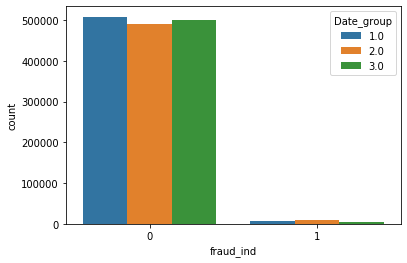

In [24]:
sns.countplot(train['fraud_ind'], hue= train['Date_group'])

In [15]:
train.describe(include='all')

,acqic,bacno,cano,conam,contp,csmcu,ecfg,etymd,flbmk,flg_3dsmk,...,iterm,locdt,loctm,mcc,mchno,ovrlt,scity,stocn,stscd,txkey
count,1.521787e+06,1.521787e+06,1.521787e+06,1.521787e+06,1.521787e+06,1.521787e+06,1521787,1.521787e+06,1509206,1509206,...,1.521787e+06,1.521787e+06,1.521787e+06,1.521787e+06,1.521787e+06,1521787,1.521787e+06,1.521787e+06,1.521787e+06,1.521787e+06
unique,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,2,2,...,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,N,N,...,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,1134512,NaN,1504133,1444867,...,NaN,NaN,NaN,NaN,NaN,1501536,NaN,NaN,NaN,NaN
mean,6.008003e+03,8.209027e+04,1.089170e+05,6.547219e+02,4.829368e+00,5.383324e+01,NaN,4.149114e+00,NaN,NaN,...,4.962784e-02,4.532732e+01,1.463152e+05,2.978089e+02,5.589022e+04,NaN,4.755128e+03,9.565116e+01,2.485499e-02,9.711265e+05
std,1.502420e+03,4.736249e+04,6.090363e+04,4.028078e+02,6.513408e-01,2.072135e+01,NaN,2.394259e+00,NaN,NaN,...,3.652493e-01,2.601889e+01,5.212107e+04,7.796778e+01,3.082297e+04,NaN,1.979815e+03,1.890027e+01,2.216804e-01,5.641322e+05
min,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,NaN,0.000000e+00,NaN,NaN,...,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,NaN,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,5.982000e+03,4.140300e+04,5.763500e+04,4.370600e+02,5.000000e+00,6.200000e+01,NaN,2.000000e+00,NaN,NaN,...,0.000000e+00,2.300000e+01,1.109310e+05,2.500000e+02,3.377400e+04,NaN,3.795000e+03,1.020000e+02,0.000000e+00,4.869475e+05
50%,6.716000e+03,8.191200e+04,1.097850e+05,5.919000e+02,5.000000e+00,6.200000e+01,NaN,4.000000e+00,NaN,NaN,...,0.000000e+00,4.500000e+01,1.515220e+05,2.640000e+02,5.936000e+04,NaN,5.817000e+03,1.020000e+02,0.000000e+00,9.795800e+05
75%,6.769000e+03,1.230590e+05,1.618760e+05,8.073400e+02,5.000000e+00,6.200000e+01,NaN,5.000000e+00,NaN,NaN,...,0.000000e+00,6.800000e+01,1.858270e+05,3.430000e+02,7.920000e+04,NaN,5.817000e+03,1.020000e+02,0.000000e+00,1.455200e+06


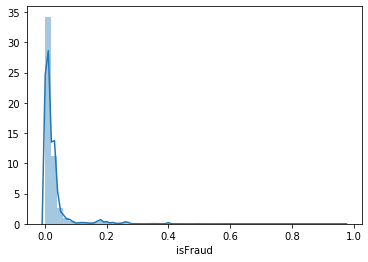

In [5]:
Final = pd.read_csv('Submission/10-15-15-54.csv')
sns.distplot(Final['isFraud'])

In [3]:
class Data():
    def __init__(self):
        self.Test_df       = pd.read_csv('test.csv')
        self.Train_df      = pd.read_csv('train.csv')
        self.All_df        = pd.concat([self.Train_df, self.Test_df], axis=0, sort = True)
        self.Record_list   = {}
        self.Cate_feat     = []
    
    def Separate_dt(self):
        self.All_df['Date_group'] = 0
        self.All_df.loc[self.All_df['locdt'] < 121, 'Date_group'] = 4
        self.All_df.loc[(self.All_df['locdt']) < 91, 'Date_group']  = 3
        self.All_df.loc[(self.All_df['locdt']) < 61, 'Date_group']  = 2
        self.All_df.loc[(self.All_df['locdt']) < 31, 'Date_group'] = 1
        self.Record_list['Separate_dt'] = True 
        
    def Set_cate_feat(self, feat_list):
        #contp、etymd、stscd、flbmk、hcefg、flg_3dsmk
        self.Cate_feat = feat_list 
        self.Record_list['Set_cate_feat'] = feat_list
        
    def Label_encoding(self, feat_list):
        #insfg、ecfg、ovrlt、flbmk、flg_3dsmk
        le = LabelEncoder()
        for feat in feat_list:
            self.All_df[feat] = le.fit_transform(self.All_df[feat].astype(str))
        
        self.Record_list['Label_encoding'] = feat_list
        
    def Drop_feat(self, feat_list):
        self.All_df.drop(feat_list, axis=1, inplace = True)
        self.Record_list['Drop_feat'] = feat_list
        
    def Return_record(self):
        self.Train_df = self.All_df[:1521787]
        self.Test_df = self.All_df[1521787:]
        
        Final_record = {
            'Train_df'    : self.Train_df,
            'Test_df'     : self.Test_df,
            'Result'      : self.Record_list,
            'Cate_feat'   : self.Cate_feat
        } 

        return Final_record

In [5]:
data = Data()
data.Label_encoding(['insfg', 'ecfg', 'ovrlt', 'flbmk', 'flg_3dsmk'])
data.Set_cate_feat(['contp', 'etymd', 'stscd', 'flbmk', 'hcefg', 'flg_3dsmk'])
data.Drop_feat(['txkey'])
#data.Separate_date()
#data.Return_record()

In [9]:
data.Train_df.stscd.dtypes

dtype('int64')

In [ ]:
data.All_df['Date_group'].value_counts()

In [ ]:
data.All_df.loc[data.All_df['Date_group'] == 4, 'fraud_ind'].value_counts()

In [ ]:
data.Test_df.locdt

In [ ]:
data.Train_df['count'] = data.Train_df.groupby(['bacno'])['fraud_ind'].transform('count')
data.Train_df['sum'] = data.Train_df.groupby(['bacno'])['fraud_ind'].transform('sum')

In [ ]:
data.Train_df['Avg'] = data.Train_df['sum'] / data.Train_df['count']

In [ ]:
data.All_df.groupby(['bacno'])['fraud_ind'].mean().value_counts()